In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
import turtle as tu
from matplotlib import animation, rc
from IPython.display import HTML, Image

### Mandelbrot Set


In [3]:
def mandelbrot(Re, Im, max_inter):
   """retorna o número de iterações necessárias para que |Z(k+1)| = (Re_z(k) + i.Im_z(k))^2  + Re_c + i.Im_c >= 2
   Aqui z_0 = 0 e cada ponto do grid representa c"""
    c = complex(Re, Im)
    z = 0.0j #definição do conjunto de mandelbrot, para diferentes pontos iniciais veja Julia Sets
 
    if(c.real*c.real + c.imag*c.imag) >= 4:
        return 0 
    else:
        for i in range(max_inter):
            z = z*z + c #processo iterativo para gerar o mandelbrot set
            if(z.real*z.real + z.imag*z.imag) >= 4:
                return i + 1
        return max_inter + 1

In [4]:
columns = 200
rows = 300

result = np.zeros([rows, columns])
for row_index, Re in enumerate(np.linspace(-2, 1 ,num = rows)):
    for column_index, Im in enumerate(np.linspace(-1, 1, num = columns)):
        result[row_index, column_index] = mandelbrot(Re, Im, 50)

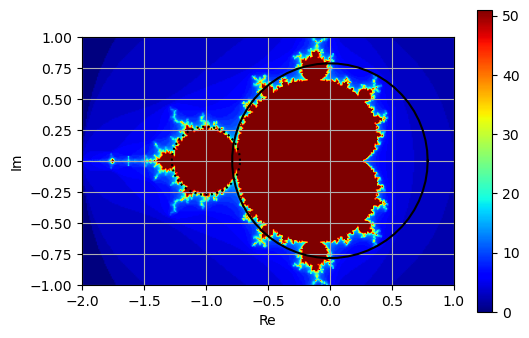

In [5]:
t = np.linspace(0,2*np.pi,60)

circulo_real = 0.7885*np.cos(t)
circulo_imag = 0.7855*np.sin(t)

circulo_real2 = -1 + 0.275*np.cos(t)
circulo_imag2 = 0 + 0.275*np.sin(t)


plt.figure(dpi=100)

plt.imshow(result.T, cmap = 'jet', interpolation = 'bilinear', extent = [-2, 1, -1, 1])
plt.plot(circulo_real,circulo_imag,'k-')
plt.plot(circulo_real2,circulo_imag2,'k:')
plt.xlabel('Re')
plt.ylabel('Im')
plt.colorbar()
plt.grid()
plt.show()

### Julia Sets

In [6]:
#função para gerar conjuntos de Julia

def julia(Re_z, Im_z, Re_c, Im_c, max_inter):
    """ retorna o número de iterações necessárias para que |Z(k+1)| = (Re_z(k) + i.Im_z(k))^2  + Re_c + i.Im_c >= 2
    aqui c é contante e cada ponto do grid representa z_0"""
    c = complex(Re_c, Im_c)
    z = complex(Re_z, Im_z)
  
    if z.real*z.real + z.imag*z.imag >= 4:
        return 0
    else:
        for i in range(max_inter):
            z = z*z + c #processo iterativo para gerar o julia set
            if(z.real*z.real + z.imag*z.imag) >= 4:
                return i + 1
        return max_inter + 1

In [7]:
#dataset

columns = 300
rows = 300

#Cada valor de c = Re_c + Im_c.i dará um conjunto de Julia diferente

pts = 2*192
result_j = np.zeros([rows, columns, pts])
a = np.zeros(pts)

for n in range(pts):
    
    a[n] = (np.pi)*(2*n/(pts-1)) #basta investigar de 0 a pi, pois o conjunto de mandelbrot é simétrico em relação ao eixo Real. Porem vou investigar de 0 a 2pi para ver o movimento.
    c = -1 + 0j + 0.275*np.exp(complex(0,a[n])) 
    Re_c = c.real
    Im_c = c.imag
    
    for row_index, Re_z in enumerate(np.linspace(-1.5, 1.5 ,num = rows)):
        for column_index, Im_z in enumerate(np.linspace(-1.5, 1.5, num = columns)):
            result_j[row_index, column_index, n] = julia(Re_z, Im_z, Re_c, Im_c, 50)

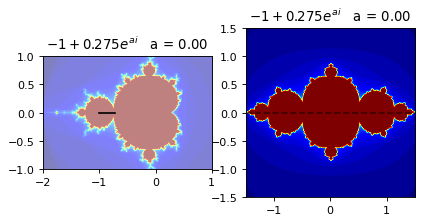

In [14]:
# Grafico animado

fig = plt.figure(dpi=80)
x = np.linspace(-1.5,1.5)


def animatedJulia(n):
    plt.clf()
    
    plt.subplot(1,2,1)
    plt.imshow(result.T, cmap = 'jet', alpha = 0.5, interpolation = 'bilinear', extent = [-2, 1, -1, 1])
    x_movel = np.linspace(-1., -1 + 0.275*np.cos(a[n]))
    y_movel = np.linspace(0, 0 + 0.275*np.sin(a[n]))
    plt.plot(x_movel, y_movel, 'k')
    plt.title('$-1 + 0.275e^{ai}$' + '   a = ' + "{:.2f}".format(a[n]*180/np.pi))
    plt.xlim(-2,1)
    plt.ylim(-1,1)
    
    plt.subplot(1,2,2)
    plt.imshow(result_j[:,:,n].T, cmap = 'jet', interpolation = 'bilinear', extent = [-1.5, 1.5, -1.5, 1.5])
    plt.plot(x, np.tan(a[n])*x, 'k--', alpha = 0.5)
    plt.title('$-1 + 0.275e^{ai}$' + '   a = ' + "{:.2f}".format(a[n]*180/np.pi))
    plt.ylim(-1.5,1.5)

anim = animation.FuncAnimation(fig,animatedJulia,frames=len(a),interval=100)

HTML(anim.to_jshtml())

In [71]:
fig.

array([ 2.        ,  1.93877551,  1.87755102,  1.81632653,  1.75510204,
        1.69387755,  1.63265306,  1.57142857,  1.51020408,  1.44897959,
        1.3877551 ,  1.32653061,  1.26530612,  1.20408163,  1.14285714,
        1.08163265,  1.02040816,  0.95918367,  0.89795918,  0.83673469,
        0.7755102 ,  0.71428571,  0.65306122,  0.59183673,  0.53061224,
        0.46938776,  0.40816327,  0.34693878,  0.28571429,  0.2244898 ,
        0.16326531,  0.10204082,  0.04081633, -0.02040816, -0.08163265,
       -0.14285714, -0.20408163, -0.26530612, -0.32653061, -0.3877551 ,
       -0.44897959, -0.51020408, -0.57142857, -0.63265306, -0.69387755,
       -0.75510204, -0.81632653, -0.87755102, -0.93877551, -1.        ])

MovieWriter writer unavailable; using Pillow instead.


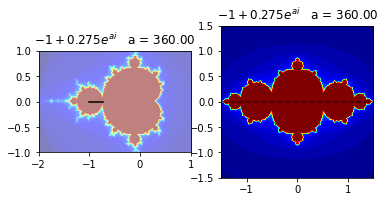

In [13]:
anim.save('./julia1.gif', writer='writer', fps=60)